In [19]:
from google.colab import drive
drive.mount("/content/drive")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [22]:
import os, zipfile

DATA_ROOT = "/content/drive/MyDrive/sprint_ai_project1_data"
ZIP_PATH  = os.path.join(DATA_ROOT, "train_annotations_clean.zip")

assert os.path.exists(ZIP_PATH), f"zip not found: {ZIP_PATH}"

with zipfile.ZipFile(ZIP_PATH, "r") as z:
    z.extractall(DATA_ROOT)

print("✅ unzip done")

✅ unzip done


In [25]:
import os, json

DATA_ROOT = os.environ.get(
    "MEDICINE_DATA_ROOT",
    "/content/drive/MyDrive/sprint_ai_project1_data"
)
ANN_ROOT = os.path.join(DATA_ROOT, "train_annotations_clean")

def collect_unique_cats(ann_root):
    cat_ids = set()
    for dirpath, _, filenames in os.walk(ann_root):
        for fn in filenames:
            if not fn.lower().endswith(".json"):
                continue
            jp = os.path.join(dirpath, fn)
            with open(jp, "r", encoding="utf-8") as f:
                coco = json.load(f)
            for ann in coco["annotations_clean"]:
                cat_ids.add(ann["category_id"])
    return sorted(list(cat_ids))

unique_cats = collect_unique_cats(ANN_ROOT)
print("unique category count:", len(unique_cats))
print("example ids:", unique_cats)


unique category count: 56
example ids: [1900, 2483, 3351, 3483, 3544, 3743, 3832, 4543, 12081, 12247, 12778, 13395, 13900, 16232, 16262, 16548, 16551, 16688, 18147, 18357, 19232, 19552, 19607, 19861, 20014, 20238, 20877, 21325, 21771, 22074, 22347, 22362, 24850, 25367, 25438, 25469, 27733, 27777, 27926, 27993, 28763, 29345, 29451, 29667, 30308, 31863, 31885, 32310, 33009, 33208, 33880, 34597, 35206, 36637, 38162, 41768]


In [26]:
# background = 0, 나머지 클래스는 1~K
catid_to_model = {cat_id: i+1 for i, cat_id in enumerate(unique_cats)}
model_to_catid = {v: k for k, v in catid_to_model.items()}

NUM_CLASSES = 1 + len(unique_cats)
print("NUM_CLASSES:", NUM_CLASSES)


NUM_CLASSES: 57


In [28]:
print(invalid_bboxes)

[]


In [57]:
from PIL import Image

IMG_ROOT = os.path.join(DATA_ROOT, "train_images")

def find_json_path(root_dir, filename):
    for dirpath, _, filenames in os.walk(root_dir):
        if filename in filenames:
            return os.path.join(dirpath, filename)
    return None

def show_problem_sample(rec):
    fn_json = rec["file"]

    # [수정] 단순히 os.path.join을 쓰는 대신 find_json_path로 하위 폴더까지 검색하여 실제 경로를 찾습니다.
    json_path = find_json_path(ANN_ROOT, fn_json)

    # 파일이 없는 경우에 대한 예외 처리
    if json_path is None:
        print(f"Error: {fn_json} 파일을 {ANN_ROOT} 및 하위 폴더에서 찾을 수 없습니다.")
        return

    # 찾은 경로(json_path)를 사용하여 파일을 엽니다.
    with open(json_path, "r", encoding="utf-8") as f:
        coco = json.load(f)

    img_info = coco["images"][0]
    img_path = os.path.join(IMG_ROOT, img_info["file_name"])
    img = Image.open(img_path).convert("RGB")

    import matplotlib.pyplot as plt
    import matplotlib.patches as patches

    fig, ax = plt.subplots(1,1, figsize=(6,6))
    ax.imshow(img); ax.set_axis_off()

    for ann in coco["annotations_clean"]:
        x, y, w, h = ann["bbox"]
        rect = patches.Rectangle(
            (x, y), w, h,
            linewidth=2,
            edgecolor="red",
            facecolor="none",
        )
        ax.add_patch(rect)
    plt.show()

# invalid가 있다면 첫 샘플 확인
if invalid_bboxes:
    show_problem_sample(invalid_bboxes[0])

In [58]:
import os
# category_id -> name 만들기
catid_to_name = {}
for dirpath, _, filenames in os.walk(ANN_ROOT):
    for fn in filenames:
        if not fn.lower().endswith(".json"):
            continue
        jp = os.path.join(dirpath, fn)
        with open(jp, "r", encoding="utf-8") as f:
            coco = json.load(f)
        for cat in coco.get("categories", []):
            catid_to_name[cat["id"]] = cat.get("name", "")

print("Top 10 (id, name, count):")
for cat_id, cnt in cat_freq.most_common(10):
    print(cat_id, catid_to_name.get(cat_id, ""), cnt)


Top 10 (id, name, count):


# 설명: category_id -> name 매핑 수집

- 목적: 모든 주석 파일에서 `categories` 배열을 읽어 `category_id`에 해당하는 이름(예: 약 이름)을 모아서 `catid_to_name` 딕셔너리를 만듭니다.

### 코드 설명
- `for cat in coco.get("categories", [])`:
  - `get`을 사용하여 `categories` 키가 없을 경우 빈 리스트를 사용해 안전하게 순회합니다.
- `catid_to_name[cat["id"]] = cat.get("name", "")`:
  - `id`를 키로, `name`을 값으로 저장합니다. `name`이 없으면 빈 문자열로 대체합니다.

### 작성 이유
- 모델 예측 결과(display)에서 클래스 아이디만 있으면 사람이 해석하기 어렵습니다. 따라서 `id->name` 매핑을 만들어 시각화나 결과 문서화 시 원문 이름을 표시할 수 있게 합니다.

In [68]:
import os, json
import torch
from torch.utils.data import Dataset
from PIL import Image
import torchvision.transforms.v2.functional as F
from torchvision.tv_tensors import Image as TvImage, BoundingBoxes

class PillMergedDataset(Dataset):
    def __init__(self, root, split="train", transforms=None):

        self.root = root
        self.split = split
        self.transforms = transforms

        if split == "train":
            self.img_dir = os.path.join(root, "train_images")
            ann_root = os.path.join(root, "train_annotations_clean")

            # file_name -> { "width": ..., "height": ..., "anns": [ann, ...], "cat_names": {cat_id: name} }
            file_to_info = {}

            for dirpath, _, filenames in os.walk(ann_root):
                for fn in filenames:
                    if not fn.lower().endswith(".json"):
                        continue
                    jp = os.path.join(dirpath, fn)
                    with open(jp, "r", encoding="utf-8") as f:
                        coco = json.load(f)

                    img = coco["images"][0]
                    file_name = img["file_name"]
                    width = img["width"]
                    height = img["height"]

                    if file_name not in file_to_info:
                        file_to_info[file_name] = {
                            "width": width,
                            "height": height,
                            "anns": [],
                            "cat_names": {},   # category_id -> name
                        }

                    # categories 배열에서 id -> name 매핑 저장
                    for cat in coco.get("categories", []):
                        cid = cat["id"]
                        cname = cat.get("name", "")
                        file_to_info[file_name]["cat_names"][cid] = cname

                    # annotations 추가
                    for ann in coco["annotations"]:
                        file_to_info[file_name]["anns"].append(ann)

            self.filenames = sorted(file_to_info.keys())
            self.file_to_info = file_to_info

        elif split == "test":
            self.img_dir = os.path.join(root, "test_images")
            self.filenames = sorted(
                f for f in os.listdir(self.img_dir)
                if f.lower().endswith(".png")
            )
            self.file_to_info = None

        else:
            raise ValueError(f"Unknown split: {split}")

    def __len__(self):
        return len(self.filenames)

    def _load_image(self, file_name: str):
        path = os.path.join(self.img_dir, file_name)
        img = Image.open(path).convert("RGB")
        return img

    def _load_target(self, file_name: str, image_id: int):
        info = self.file_to_info[file_name]
        anns = info["anns"]
        cat_names_map = info.get("cat_names", {})

        boxes, labels, areas, iscrowd = [], [], [], []
        names = []

        for ann in anns:
            x, y, w, h = ann["bbox"]
            if w <= 0 or h <= 0:
                continue

            orig_cat = ann["category_id"]
            if orig_cat not in catid_to_model:
                continue
            model_label = catid_to_model[orig_cat]

            boxes.append([x, y, x + w, y + h])
            labels.append(model_label)
            areas.append(ann.get("area", w * h))
            iscrowd.append(ann.get("iscrowd", 0))

            # category_id로부터 이름 가져오기 (없으면 빈 문자열)
            pill_name = cat_names_map.get(orig_cat, "")
            names.append(pill_name)

        if len(boxes) == 0:
            boxes = torch.zeros((0, 4), dtype=torch.float32)
            labels = torch.zeros((0,), dtype=torch.int64)
            areas = torch.zeros((0,), dtype=torch.float32)
            iscrowd = torch.zeros((0,), dtype=torch.int64)
            names = []
        else:
            boxes = torch.as_tensor(boxes, dtype=torch.float32)
            labels = torch.as_tensor(labels, dtype=torch.int64)
            areas = torch.as_tensor(areas, dtype=torch.float32)
            iscrowd = torch.as_tensor(iscrowd, dtype=torch.int64)

        target = {
            "boxes": boxes,
            "labels": labels,
            "image_id": torch.tensor([image_id]),
            "area": areas,
            "iscrowd": iscrowd,
            "names": names,   # 추가
        }
        return target



    def __getitem__(self, idx):
        file_name = self.filenames[idx]
        img = self._load_image(file_name)

        image_id = idx  # 학습 내부용 id

        if self.split == "train":
            target = self._load_target(file_name, image_id)
        else:
            target = {"image_id": torch.tensor([image_id])}

        img = TvImage(F.pil_to_tensor(img))  # [C,H,W], uint8

        if self.split == "train":
            target["boxes"] = BoundingBoxes(
                target["boxes"], format="XYXY", canvas_size=F.get_size(img)
            )

        if self.transforms is not None:
            img, target = self.transforms(img, target)

        return img, target


In [69]:
def show_sample(dataset, idx=0):
    img, target = dataset[idx]

    if isinstance(img, TvImage):
        img_pil = F.to_pil_image(img).convert("RGB")
    else:
        img_pil = F.to_pil_image(img)

    boxes = target.get("boxes", None)
    labels = target.get("labels", None)
    names = target.get("names", None)

    if isinstance(boxes, BoundingBoxes):
        boxes = torch.as_tensor(boxes, dtype=torch.float32)

    fig, ax = plt.subplots(1, 1, figsize=(8, 8))
    ax.imshow(img_pil)
    ax.set_axis_off()

    if boxes is not None and len(boxes) > 0:
        for i, box in enumerate(boxes):
            x1, y1, x2, y2 = box.tolist()
            w = x2 - x1
            h = y2 - y1

            rect = patches.Rectangle(
                (x1, y1), w, h,
                linewidth=2,
                edgecolor="red",
                facecolor="none"
            )
            ax.add_patch(rect)

            # pill 이름 텍스트 구성
            text = ""
            if names is not None and i < len(names) and names[i]:
                text = names[i]
            elif labels is not None and len(labels) > i:
                text = f"id={int(labels[i])}"

            ax.text(
                x1, max(y1 - 3, 0),
                text,
                fontsize=11,
                color="blue",
                bbox=dict(facecolor="white", edgecolor="white", alpha=0.9, pad=2)
            )

    ax.set_title(f"index={idx}, image_id={int(target['image_id'][0])}")
    plt.tight_layout()
    plt.show()


In [74]:
import matplotlib.pyplot as plt
from matplotlib import font_manager, rc

FONT_PATH = "/content/drive/MyDrive/sprint_ai_project1_data/malgun.ttf"

# 1) 폰트 파일을 matplotlib에 등록
font_manager.fontManager.addfont(FONT_PATH)

# 2) 등록된 폰트의 "정확한 이름" 얻기
font_name = font_manager.FontProperties(fname=FONT_PATH).get_name()

# 3) 그 이름으로 폰트 적용
rc("font", family=font_name)
plt.rcParams["axes.unicode_minus"] = False

print("✅ font loaded:", font_name)


✅ font loaded: Malgun Gothic


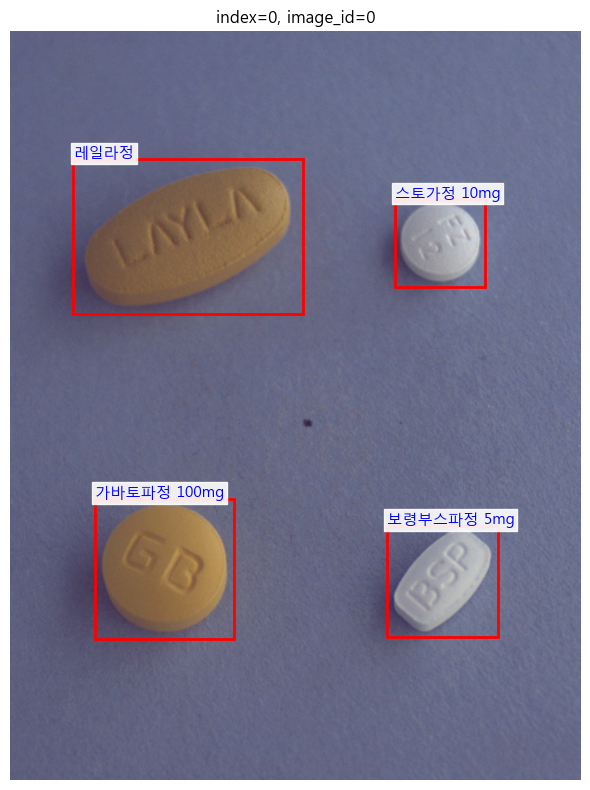

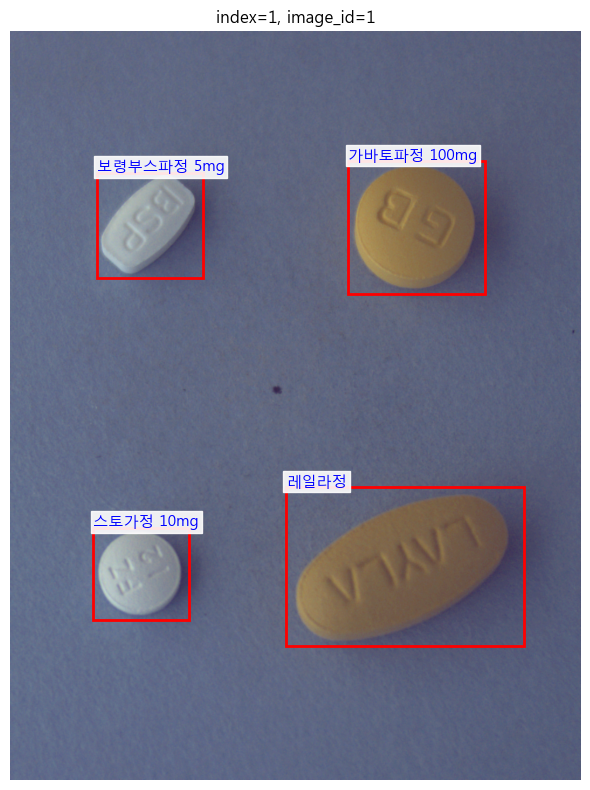

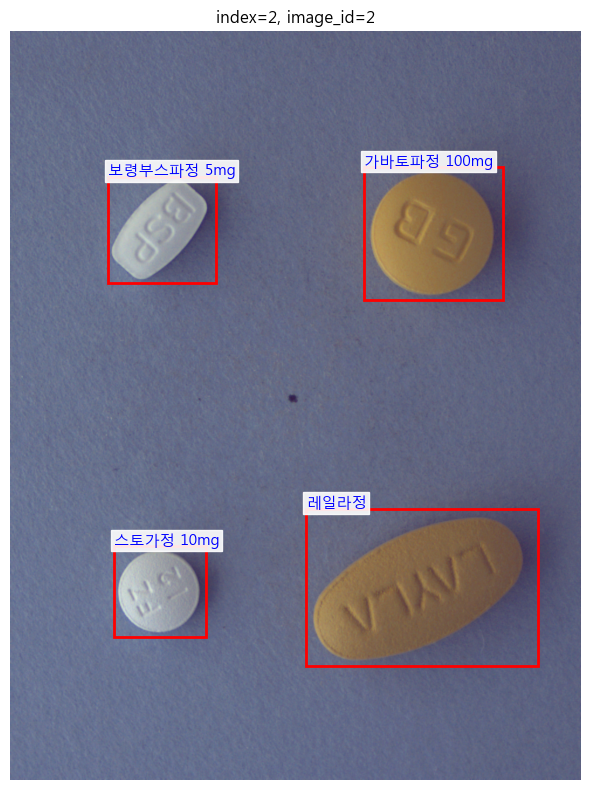

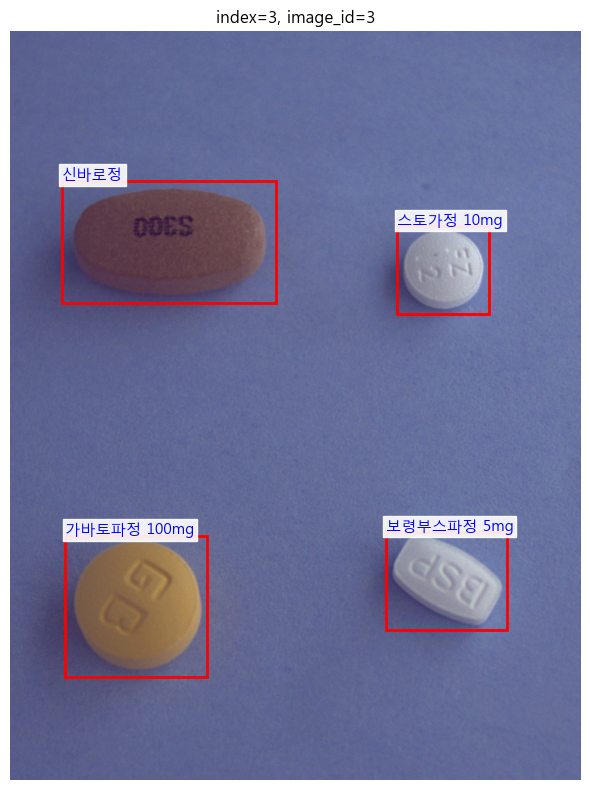

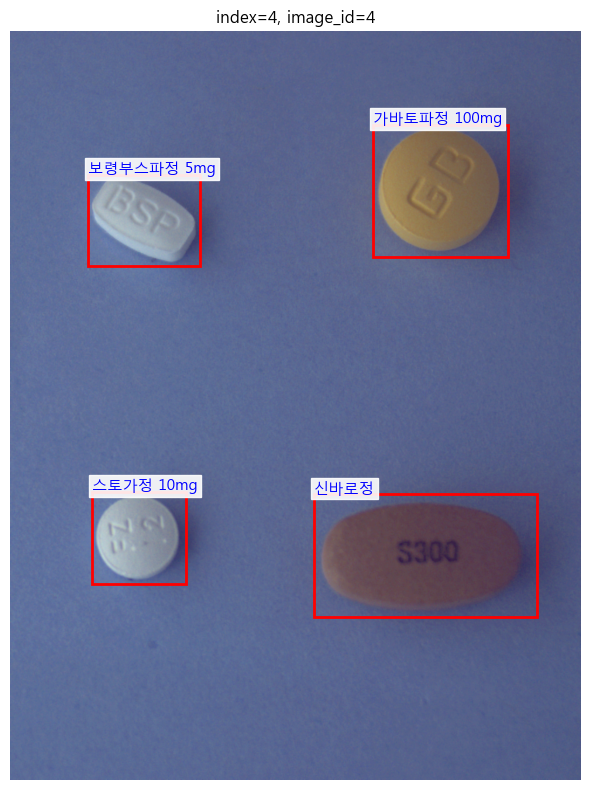

In [75]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib import font_manager, rc

#한글 설정 - 윈도우
font_path = "/content/drive/MyDrive/sprint_ai_project1_data/malgun.ttf"
font = font_manager.FontProperties(fname=font_path).get_name()
rc('font', family=font)

#마이너스 깨짐 방지
plt.rcParams['axes.unicode_minus'] = False

ds = PillMergedDataset(root=DATA_ROOT, split="train", transforms=None)
for i in range(5):
    show_sample(ds, idx=i)


In [76]:
img, target = ds[3]   # index=3 이미지
print("boxes:", target["boxes"])
print("labels:", target["labels"])
print("names:", target.get("names"))


boxes: BoundingBoxes([[ 642.,  856.,  850., 1023.],
               [  94.,  862.,  336., 1104.],
               [ 662.,  333.,  819.,  483.],
               [  88.,  255.,  454.,  464.]], format=BoundingBoxFormat.XYXY, canvas_size=[1280, 976], clamping_mode=soft)
labels: tensor([ 1, 16, 23, 49])
names: ['보령부스파정 5mg', '가바토파정 100mg', '스토가정 10mg', '신바로정']


In [77]:
import torchvision.transforms.v2 as T

train_transform = T.Compose([
    T.ToDtype(torch.float32, scale=True),        # [0,255] → [0,1]
    T.RandomHorizontalFlip(p=0.5),
    T.RandomResize(min_size=640, max_size=800),  # 짧은 변 기준 resize
    T.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225)),
])

test_transform = T.Compose([
    T.ToDtype(torch.float32, scale=True),
    T.Resize(640),
    T.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225)),
])

In [80]:
DATA_ROOT = os.environ.get(
    "MEDICINE_DATA_ROOT",
    "/content/drive/MyDrive/sprint_ai_project1_data"
)

train_dataset = PillMergedDataset(
    root=DATA_ROOT,
    split="train",
    transforms=train_transform
)

test_dataset = PillMergedDataset(
    root=DATA_ROOT,
    split="test",
    transforms=test_transform
)

In [81]:
#Detection용 collate_fn. 리스트 그대로 넘기도록 따로 정의
def detection_collate_fn(batch):
    """
    batch: [(img1, target1), (img2, target2), ...]
    return: (list_of_images, list_of_targets)
    """
    images = [b[0] for b in batch]
    targets = [b[1] for b in batch]
    return images, targets


In [82]:
from torch.utils.data import DataLoader
BATCH_SIZE = 4

train_loader = DataLoader(
    train_dataset,
    batch_size=BATCH_SIZE,
    shuffle=True,
    collate_fn=detection_collate_fn,

    pin_memory=True,
)

test_loader = DataLoader(
    test_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    collate_fn=detection_collate_fn,
    pin_memory=True,
)


In [83]:
images, targets = next(iter(train_loader))
print(len(images), type(images[0]), images[0].shape)
print(len(targets), targets[0].keys(), targets[0]["boxes"].shape)


4 <class 'torchvision.tv_tensors._image.Image'> torch.Size([3, 883, 674])
4 dict_keys(['boxes', 'labels', 'image_id', 'area', 'iscrowd', 'names']) torch.Size([3, 4])


In [84]:
import torchvision
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

def create_model(num_classes: int):
    # COCO pretrained Faster R-CNN
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(
        weights="COCO_V1"
    )
    in_features = model.roi_heads.box_predictor.cls_score.in_features

    # num_classes = (클래스 수 + 1, background 포함)
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
    return model


In [85]:
for images, targets in train_loader:
    labels = targets[0]["labels"]
    print("min label:", labels.min().item(), "max label:", labels.max().item())
    break


min label: 3 max label: 51


In [86]:
import torch

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
lr = 0.01

model = create_model(NUM_CLASSES)
model.to(device)

params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(
    params,
    lr=lr,
    momentum=0.9,
    weight_decay=0.0005,
)
lr_scheduler = torch.optim.lr_scheduler.StepLR(
    optimizer,
    step_size=11,
    gamma=0.5,
)


Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth


100%|██████████| 160M/160M [00:01<00:00, 161MB/s]


In [ ]:
#from torch.optim.lr_scheduler import MultiStepLR
#
#scheduler = MultiStepLR(
    #optimizer,
    #milestones=[20, 40],
    #gamma=0.5,
#)
#몇 에폭마다 gamma 배율로 lr 감소하는지 정하는 함수입니다

In [87]:
from tqdm import tqdm

def train_one_epoch(model, optimizer, data_loader, device, epoch, print_freq=50):
    model.train()
    running_loss = 0.0
    for step, (images, targets) in enumerate(tqdm(data_loader, desc=f"Epoch {epoch}")):
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) if torch.is_tensor(v) else v
                    for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())
        loss_value = losses.item()
        running_loss += loss_value

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

    return running_loss / max(1, len(data_loader))


In [88]:
def train_only(
    model,
    train_loader,
    optimizer,
    lr_scheduler,
    device,
    num_epochs=10,
    print_freq=50,
    save_path="last_model.pth",
):
    for epoch in range(1, num_epochs + 1):
        train_loss = train_one_epoch(
            model, optimizer, train_loader, device, epoch, print_freq=print_freq
        )
        print(f"[Epoch {epoch}] train_loss: {train_loss:.4f}")

        lr_scheduler.step()

    torch.save(model.state_dict(), save_path)
    print(f"Saved last model to {save_path}")

In [90]:
NUM_EPOCHS = 5

train_only(
    model=model,
    train_loader=train_loader,
    optimizer=optimizer,
    lr_scheduler=lr_scheduler,
    device=device,
    num_epochs=NUM_EPOCHS,
    save_path="last_model.pth",
)


Epoch 1: 100%|██████████| 58/58 [01:00<00:00,  1.05s/it]


[Epoch 1] train_loss: 0.0668


Epoch 2: 100%|██████████| 58/58 [01:00<00:00,  1.04s/it]


[Epoch 2] train_loss: 0.0500


Epoch 3: 100%|██████████| 58/58 [01:00<00:00,  1.05s/it]


[Epoch 3] train_loss: 0.0421


Epoch 4: 100%|██████████| 58/58 [01:00<00:00,  1.04s/it]


[Epoch 4] train_loss: 0.0405


Epoch 5: 100%|██████████| 58/58 [01:00<00:00,  1.04s/it]


[Epoch 5] train_loss: 0.0404
Saved last model to last_model.pth


In [91]:
torch.cuda.empty_cache()
torch.cuda.ipc_collect()

In [92]:
model.eval()
images, _ = next(iter(test_loader))
images = [img.to(device) for img in images]

with torch.no_grad():
    outputs = model(images)

out = outputs[0]
print("boxes:", out["boxes"].shape)
print("scores:", out["scores"][:10])


boxes: torch.Size([14, 4])
scores: tensor([0.9938, 0.9506, 0.9319, 0.7001, 0.2033, 0.1801, 0.1585, 0.1331, 0.1139,
        0.0848], device='cuda:0')


In [93]:
import torch

IMAGENET_MEAN = torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1)
IMAGENET_STD  = torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1)

def denormalize(img_tensor):
    """
    img_tensor: [C,H,W], float32, 정규화된 텐서
    반환: [C,H,W], 0~1 범위로 복원된 텐서
    """
    return img_tensor * IMAGENET_STD + IMAGENET_MEAN


In [94]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import torchvision.transforms.v2.functional as F
from torchvision.tv_tensors import Image as TvImage
import torch

def visualize_prediction(image, boxes, labels, scores, names=None,
                         score_thresh=0.3, title=None):
    """
    image: TvImage or tensor [C,H,W]
    boxes: tensor [N,4] (XYXY, CPU)
    labels: tensor [N]
    scores: tensor [N]
    names:  list[str] or None  (예측 클래스 이름)
    """
    # image: TvImage or tensor [C,H,W] (정규화된 상태)

    if isinstance(image, TvImage):
        img_t = torch.as_tensor(image, dtype=torch.float32)
    else:
        img_t = image.clone().detach()

    # 역정규화
    img_t = denormalize(img_t)
    img_t = img_t.clamp(0, 1)

    img_pil = F.to_pil_image(img_t).convert("RGB")

    boxes = boxes.cpu()
    labels = labels.cpu()
    scores = scores.cpu()

    fig, ax = plt.subplots(1, 1, figsize=(6, 6))
    ax.imshow(img_pil)
    ax.set_axis_off()

    for i, box in enumerate(boxes):
        if scores[i] < score_thresh:
            continue

        x1, y1, x2, y2 = box.tolist()
        w = x2 - x1
        h = y2 - y1

        rect = patches.Rectangle(
            (x1, y1), w, h,
            linewidth=2,
            edgecolor="cyan",
            facecolor="none",
        )
        ax.add_patch(rect)

        if names is not None and i < len(names):
            text = f"{names[i]} {scores[i]:.2f}"
        else:
            text = f"id={int(labels[i])} {scores[i]:.2f}"

        ax.text(
            x1, y1 - 5,
            text,
            fontsize=9,
            color="blue",
            fontweight="bold",
            bbox=dict(facecolor="white", edgecolor="white", alpha=0.9, pad=2),
        )

    if title:
        ax.set_title(title)
    plt.tight_layout()
    plt.show()


In [95]:
@torch.no_grad()
def show_test_predictions(model,
                          test_loader,
                          test_dataset,
                          model_to_catid,
                          catid_to_name,   # category_id -> 약 이름 dict
                          device,
                          max_images=5,
                          score_thresh=0.3):
    """
    catid_to_name: {category_id: "레일라정", ...}
    """
    model.eval()
    model.to(device)

    shown = 0
    idx_offset = 0

    for images, targets in test_loader:
        images = [img.to(device) for img in images]
        outputs = model(images)  # list[dict]

        for i, output in enumerate(outputs):
            if shown >= max_images:
                return

            ds_idx = idx_offset + i
            file_name = test_dataset.filenames[ds_idx]

            boxes = output["boxes"]
            labels = output["labels"]
            scores = output["scores"]

            # 모델 label(1~K) -> 원래 category_id -> 이름
            names = []
            for lab in labels.cpu().tolist():
                cat_id = model_to_catid.get(int(lab), None)
                if cat_id is not None and cat_id in catid_to_name:
                    names.append(catid_to_name[cat_id])
                else:
                    names.append(f"id={lab}")

            # 시각화
            visualize_prediction(
                image=images[i].cpu(),
                boxes=boxes,
                labels=labels,
                scores=scores,
                names=names,
                score_thresh=score_thresh,
                title=f"{file_name}",
            )

            shown += 1

        idx_offset += len(images)


In [96]:
# train_annotations 전체를 돌면서 category_id -> name 매핑 만들기
catid_to_name = {}
for dirpath, _, filenames in os.walk(ANN_ROOT):
    for fn in filenames:
        if not fn.lower().endswith(".json"):
            continue
        jp = os.path.join(dirpath, fn)
        with open(jp, "r", encoding="utf-8") as f:
            coco = json.load(f)
        for cat in coco.get("categories", []):
            catid_to_name[cat["id"]] = cat.get("name", "")


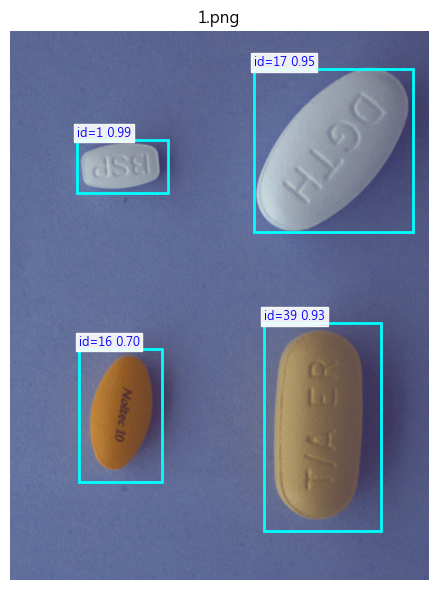

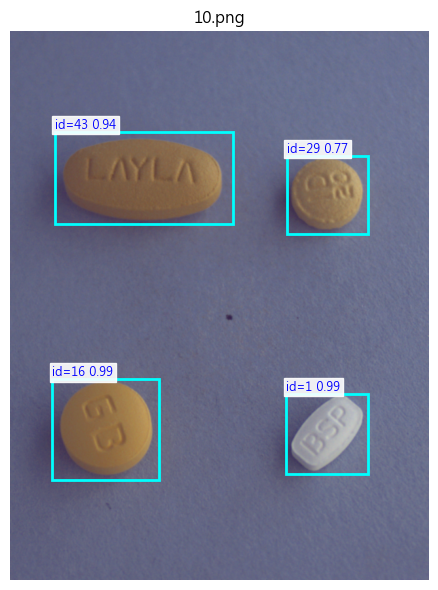

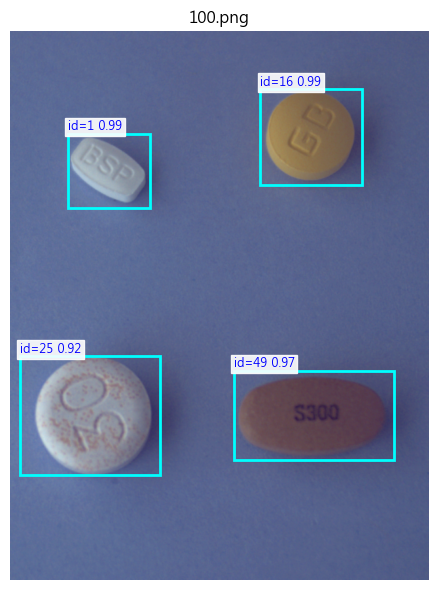

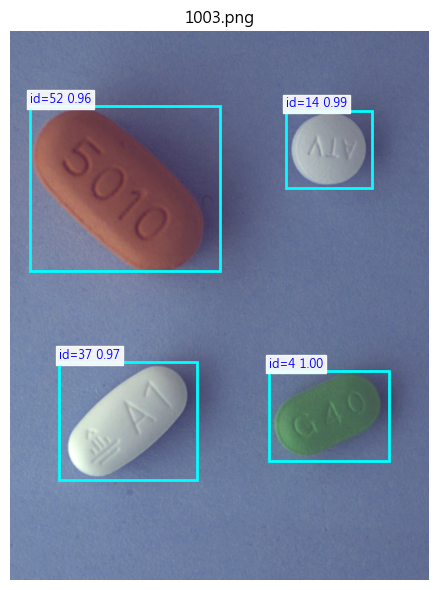

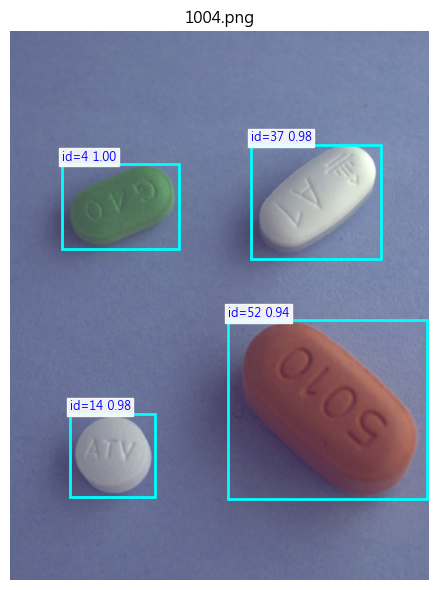

...

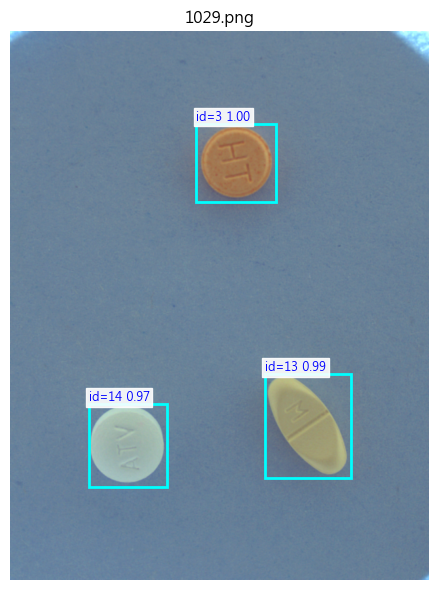

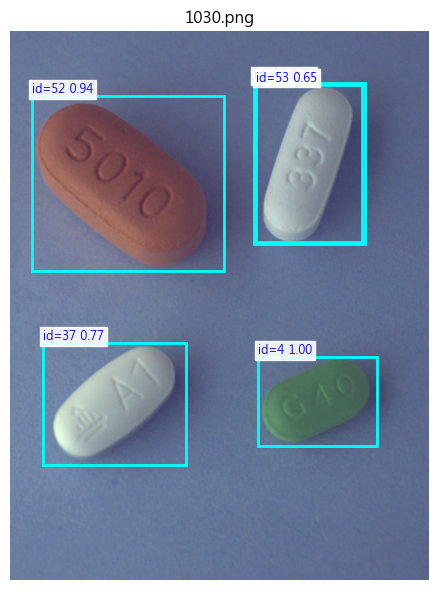

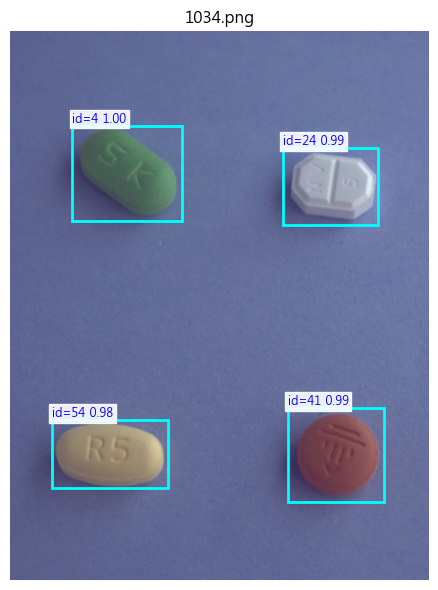

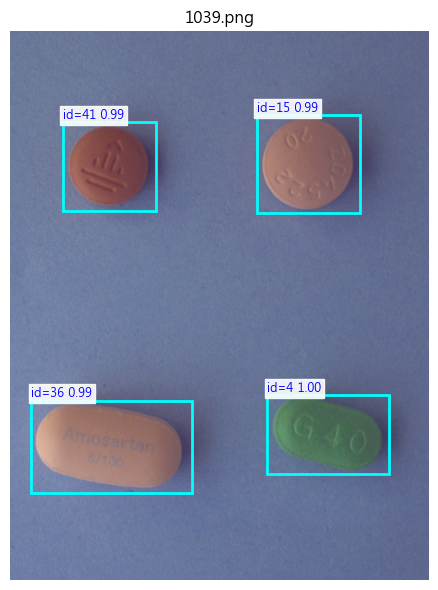

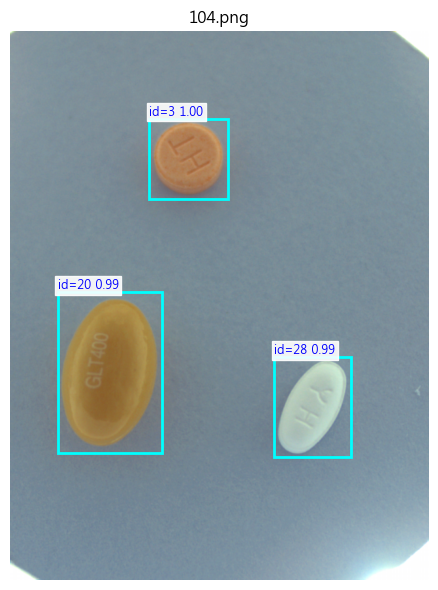

In [97]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.load_state_dict(torch.load("last_model.pth", map_location=device))

min_score = 0.5

show_test_predictions(
    model=model,
    test_loader=test_loader,
    test_dataset=test_dataset,
    model_to_catid=model_to_catid,
    catid_to_name=catid_to_name,
    device=device,
    max_images=30,
    score_thresh=min_score,
)


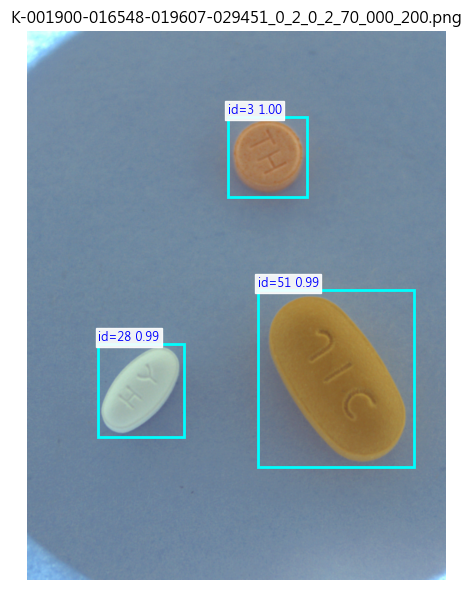

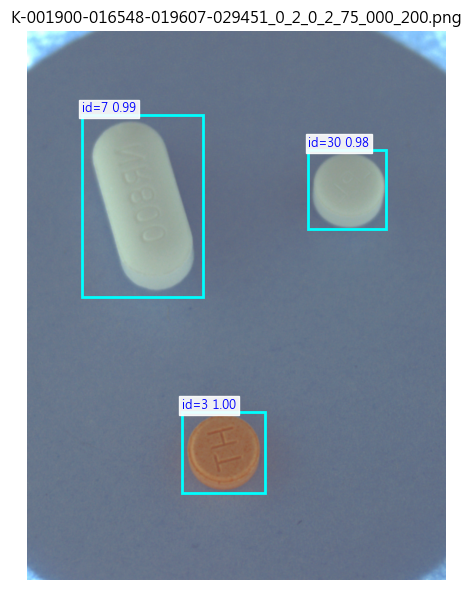

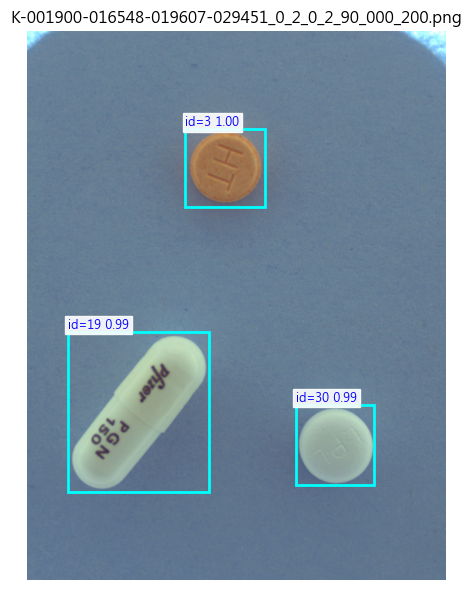

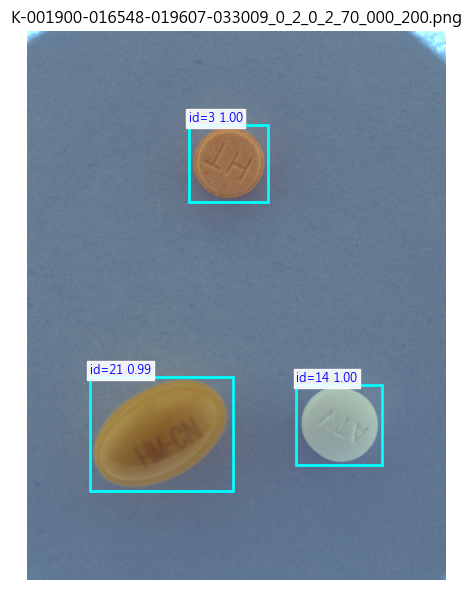

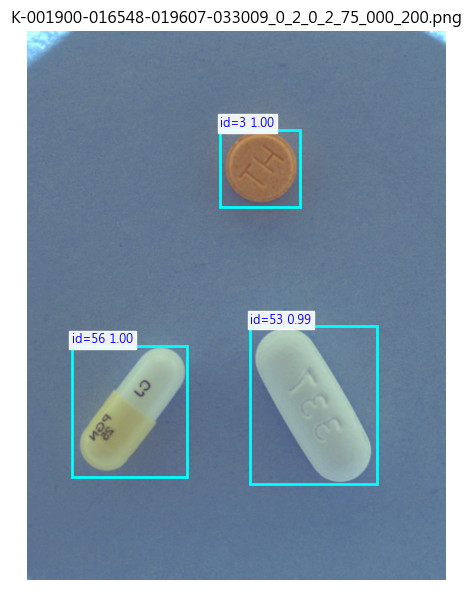

...

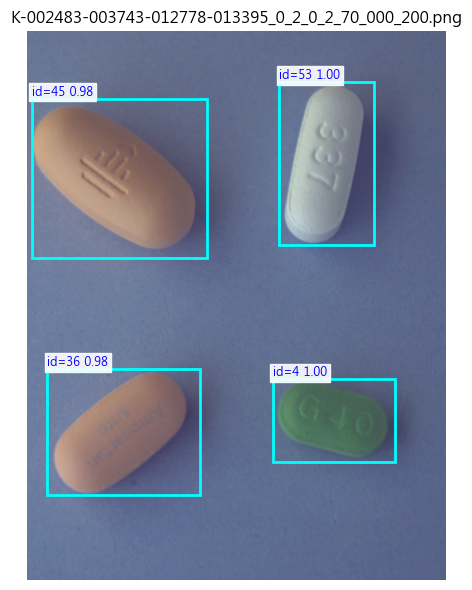

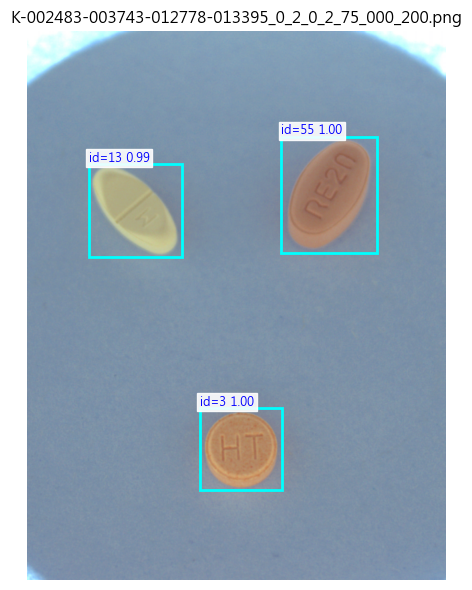

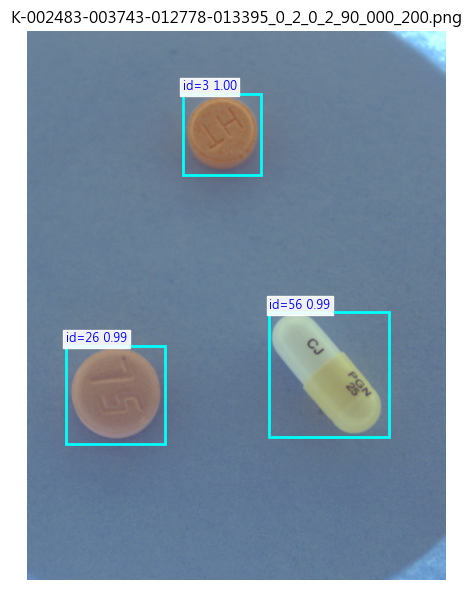

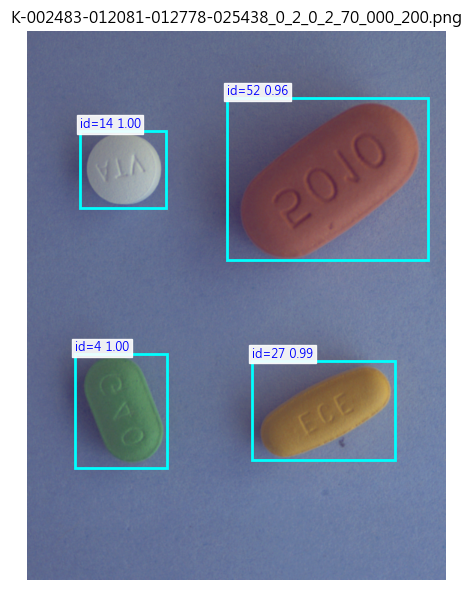

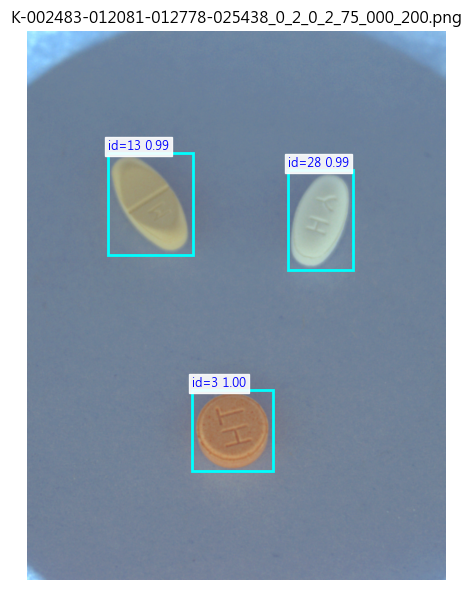

In [99]:
show_test_predictions(
    model=model,
    test_loader=train_loader,
    test_dataset=train_dataset,
    model_to_catid=model_to_catid,
    catid_to_name=catid_to_name,
    device=device,
    max_images=20,
    score_thresh=min_score,
)


In [100]:
import torch
from collections import defaultdict
from tqdm import tqdm

from torchvision.ops import box_iou

from torchvision.models.detection._utils import Matcher
from torchvision.ops import box_iou
import numpy as np

In [101]:
@torch.no_grad()
def evaluate_map(model, data_loader, device, score_thresh=0.05):
    model.eval()
    model.to(device)

    iou_thresholds = np.arange(0.5, 1.0, 0.05)
    aps = []

    for iou_thresh in iou_thresholds:
        tp, fp, fn = 0, 0, 0

        for images, targets in tqdm(data_loader, desc=f"Evaluating IoU={iou_thresh:.2f}"):
            images = [img.to(device) for img in images]
            outputs = model(images)

            for output, target in zip(outputs, targets):
                gt_boxes = target["boxes"].cpu()
                gt_labels = target["labels"].cpu()

                pred_boxes = output["boxes"].cpu()
                pred_scores = output["scores"].cpu()
                pred_labels = output["labels"].cpu()

                # score threshold
                keep = pred_scores >= score_thresh
                pred_boxes = pred_boxes[keep]
                pred_labels = pred_labels[keep]

                if len(gt_boxes) == 0:
                    fp += len(pred_boxes)
                    continue

                if len(pred_boxes) == 0:
                    fn += len(gt_boxes)
                    continue

                ious = box_iou(pred_boxes, gt_boxes)

                matched_gt = set()
                for i in range(len(pred_boxes)):
                    max_iou, gt_idx = ious[i].max(0)
                    if max_iou >= iou_thresh and gt_idx.item() not in matched_gt:
                        tp += 1
                        matched_gt.add(gt_idx.item())
                    else:
                        fp += 1

                fn += len(gt_boxes) - len(matched_gt)

        precision = tp / max(tp + fp, 1)
        recall = tp / max(tp + fn, 1)
        ap = precision * recall
        aps.append(ap)

    mean_ap = np.mean(aps)

    return {
        "AP@[0.50:0.95]": mean_ap,
        "AP50": aps[0],
        "AP75": aps[5],
    }

In [102]:
metrics = evaluate_map(
    model=model,
    data_loader=train_loader,   # or val_loader
    device=device,
    score_thresh=0.3,
)

print("📊 mAP results")
for k, v in metrics.items():
    print(f"{k}: {v:.4f}")


Evaluating IoU=0.95: 100%|██████████| 58/58 [00:50<00:00,  1.14it/s]

📊 mAP results
AP@[0.50:0.95]: 0.9296
AP50: 0.9732
AP75: 0.9707
